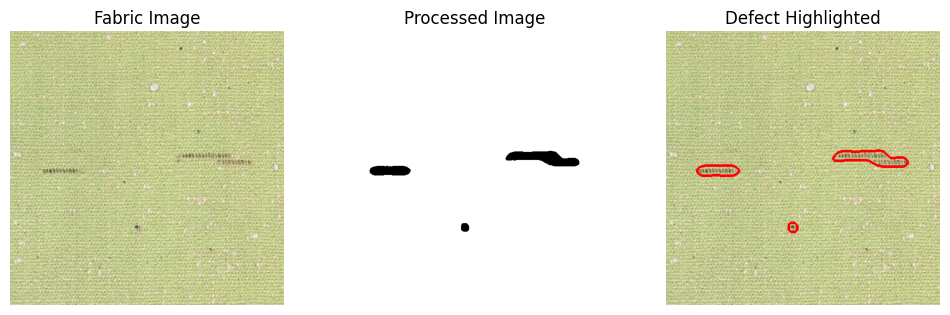

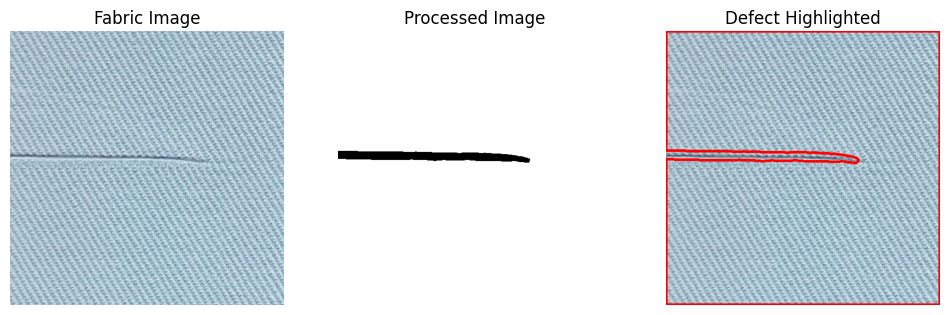

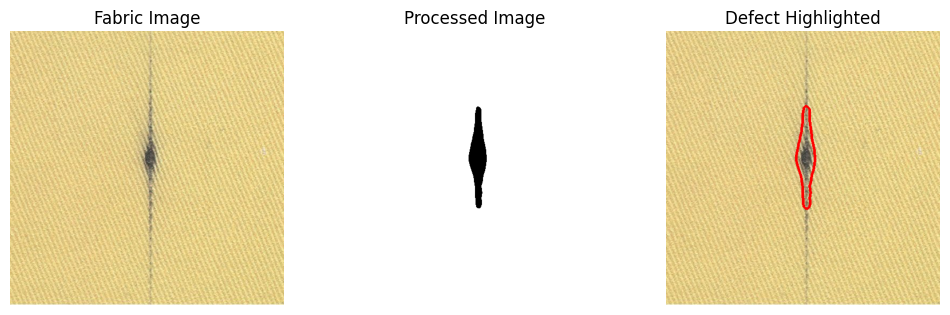

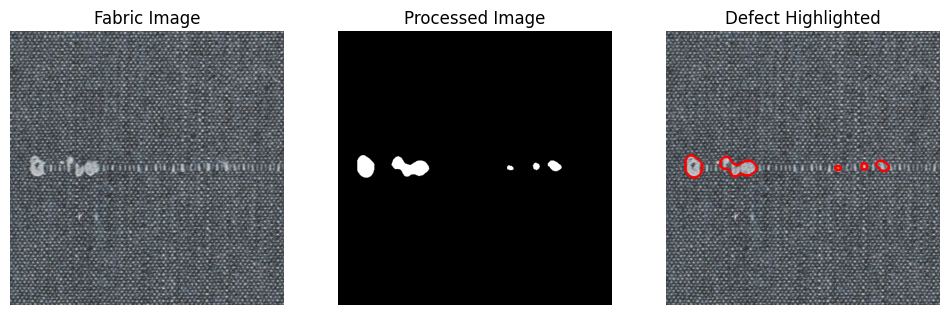

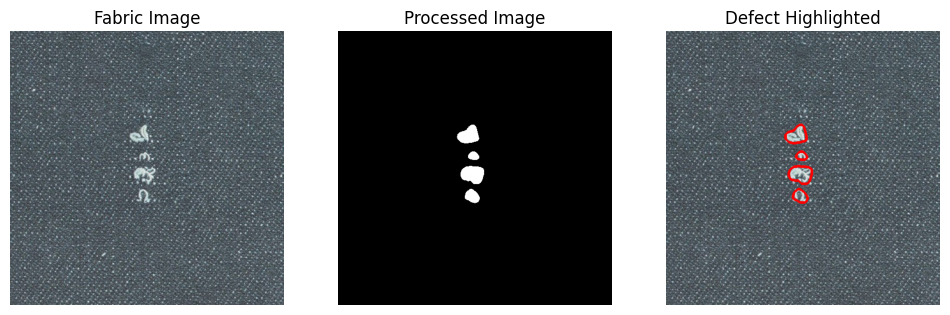

...

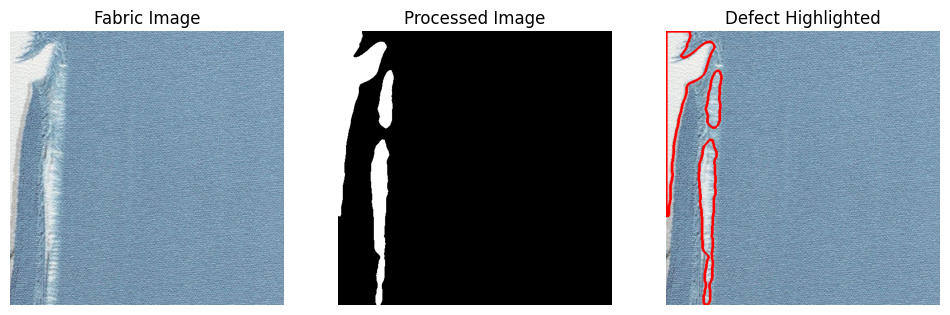

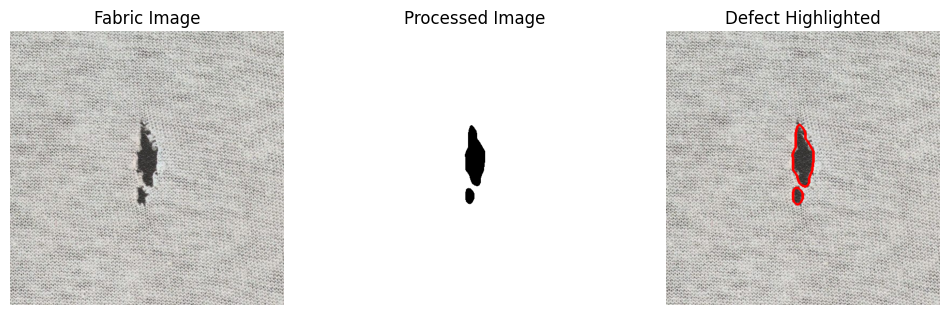

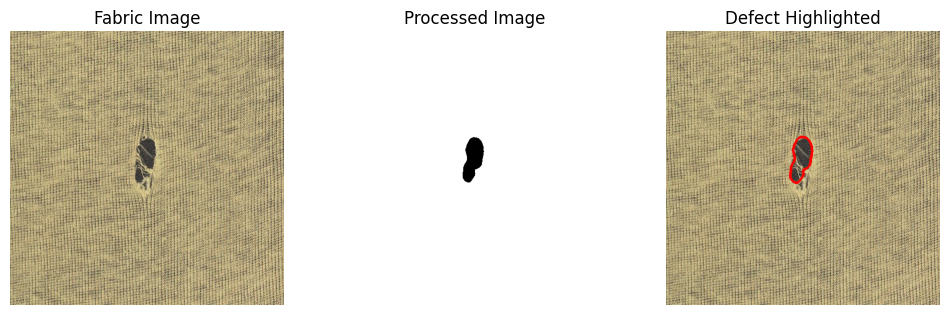

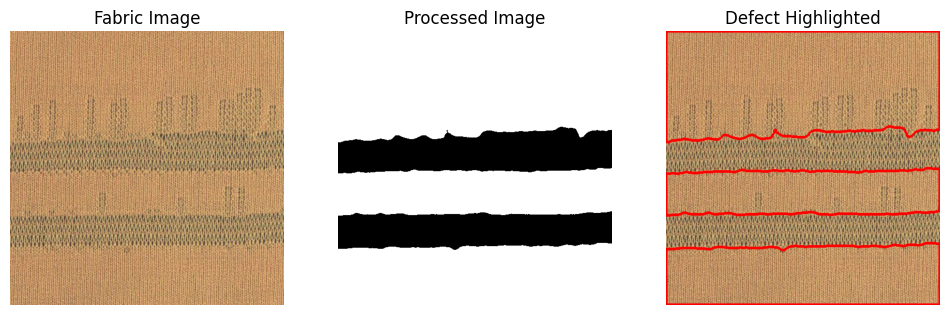

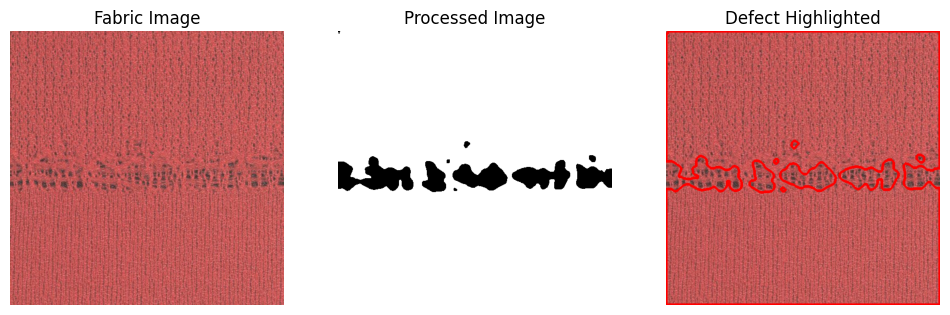

In [5]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

def preprocess(image):
    #Convert to HSV color space
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    #Extract brightness channel (value)
    v = hsv[:,:,2]
    #Apply blur to reduce noise
    blr = cv2.blur(v, (15, 15))
    #Denoise using Non-Local Means Denoising
    dst = cv2.fastNlMeansDenoising(blr, None, 10, 7, 21)
    #Apply thresholding to create a binary image
    _, binary = cv2.threshold(dst, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    return binary

def postprocess(image, original_image):
    #Create a kernel for morphological operations
    kernel = np.ones((5, 5), np.uint8)
    #Erosion to remove small bright regions and enhance dark regions
    erosion = cv2.erode(image, kernel, iterations=1)
    #Dilation to fill gaps and holes in the detected regions
    dilation = cv2.dilate(erosion, kernel, iterations=1)
    #Find contours in the processed image
    contours, _ = cv2.findContours(dilation, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    #Draw contours on the original image to highlight defects
    for cnt in contours:
        area = cv2.contourArea(cnt)
        #Highlight contours with area less than a threshold (indicative of defects)
        if area < 261121.0:
            cv2.drawContours(original_image, [cnt], -1, (0, 0, 255), 3)  #Red color for defects
    return original_image

def defect_detect(image):
    img = image.copy()
    #Preprocess the input image
    preprocessed_image = preprocess(img)
    #Postprocess the preprocessed image to detect and highlight defects
    postprocessed_image = postprocess(preprocessed_image, img)
    return postprocessed_image, preprocessed_image

#Path to the input images folder
input_folder = 'INPUT_images'

#Process each image in the folder
for filename in os.listdir(input_folder):
    #Read the image
    image_path = os.path.join(input_folder, filename)
    image = cv2.imread(image_path)
    
    #Detect and highlight defects in the image
    result_image, preprocessed_image = defect_detect(image)
    
    #Display the Fabric image
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Fabric Image')
    plt.axis('off')
    
    #Display the processed image
    plt.subplot(1, 3, 2)
    plt.imshow(preprocessed_image, cmap='gray')
    plt.title('Processed Image')
    plt.axis('off')
    
    #The defects in the Fabric image are highlighted and displayed
    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
    plt.title('Defect Highlighted')
    plt.axis('off')
    
    plt.show()

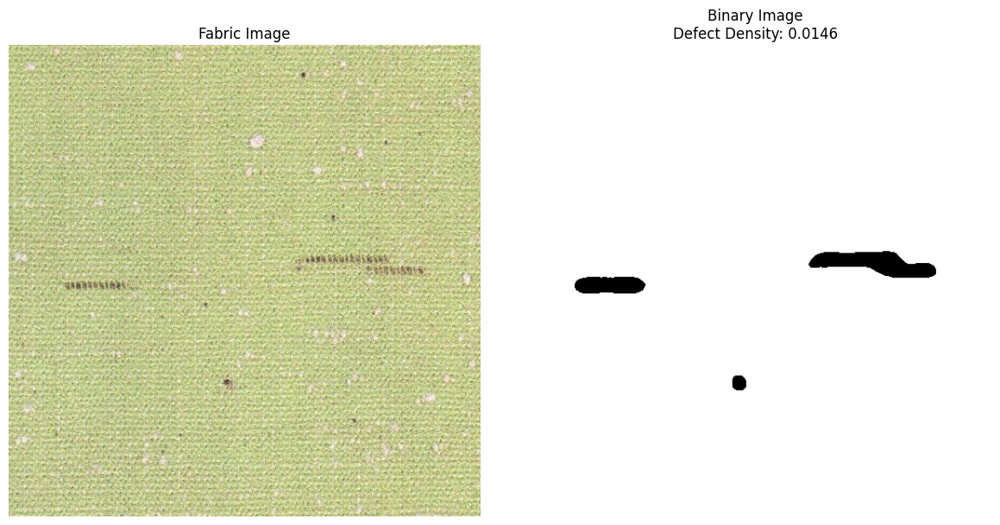

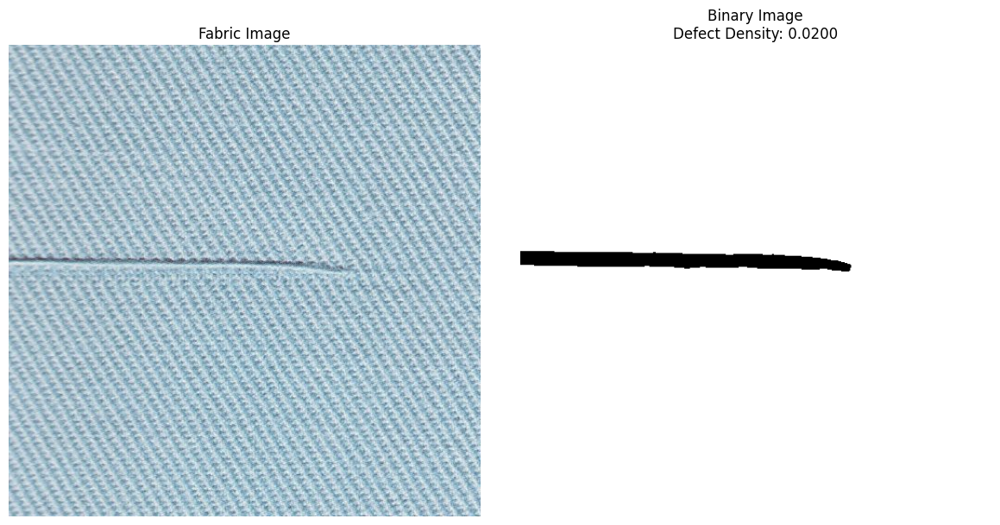

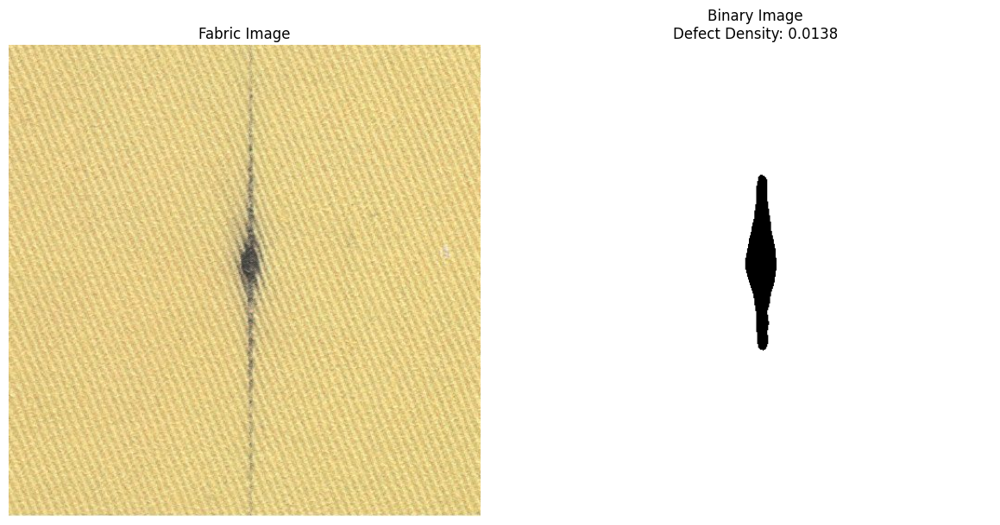

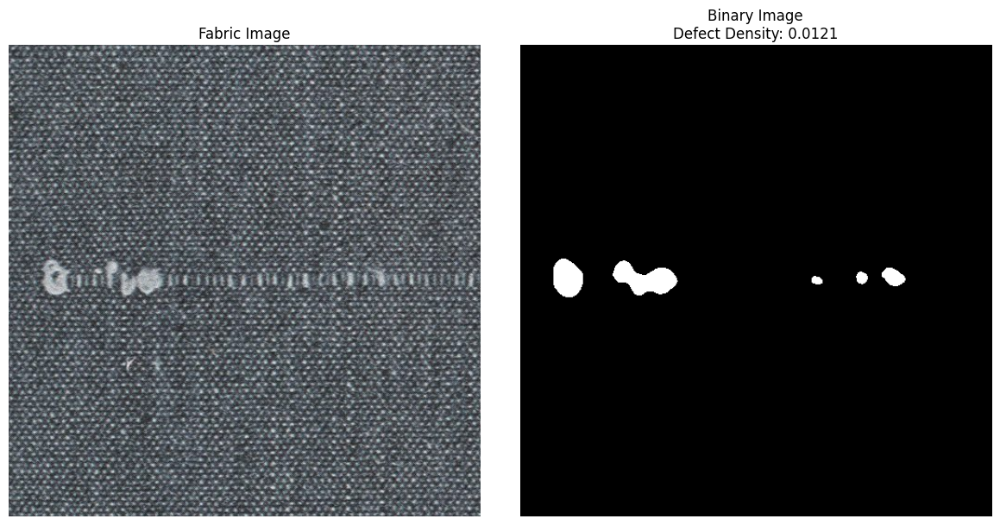

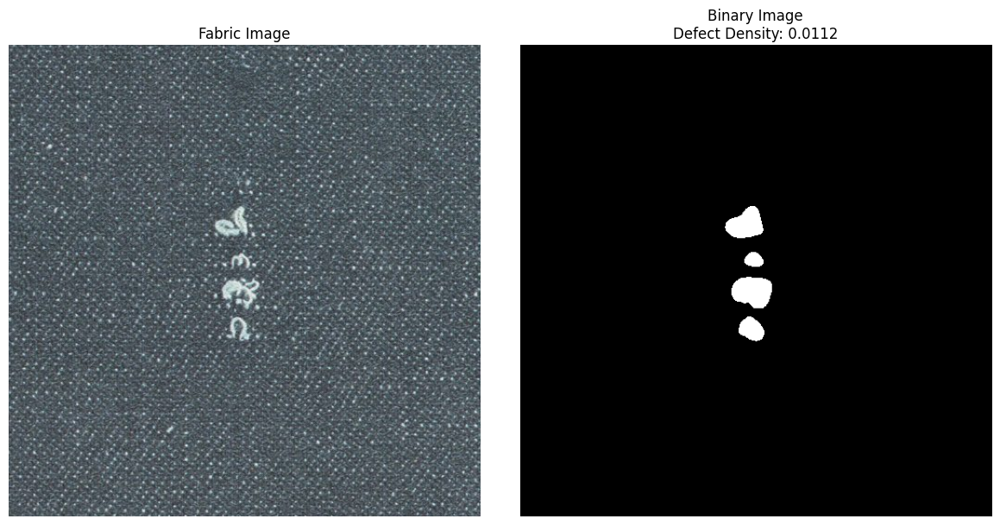

...

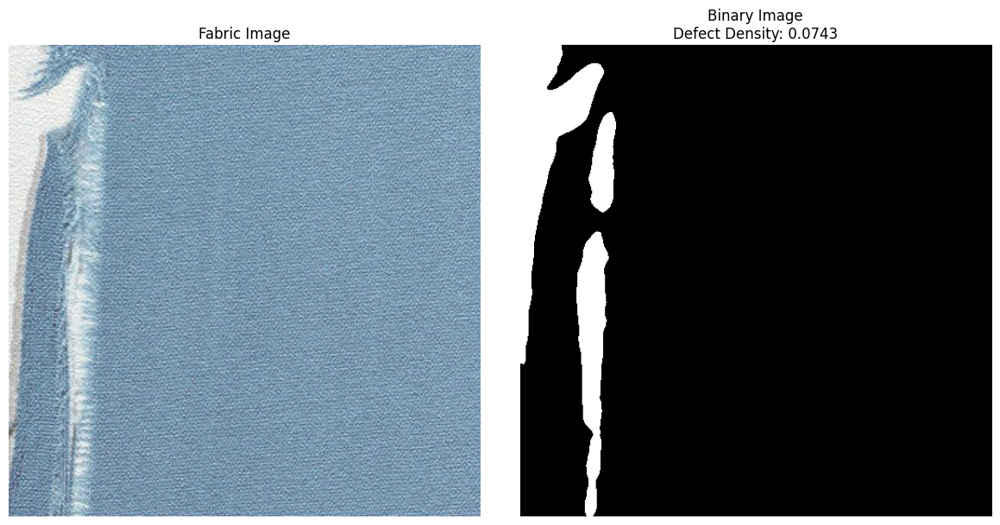

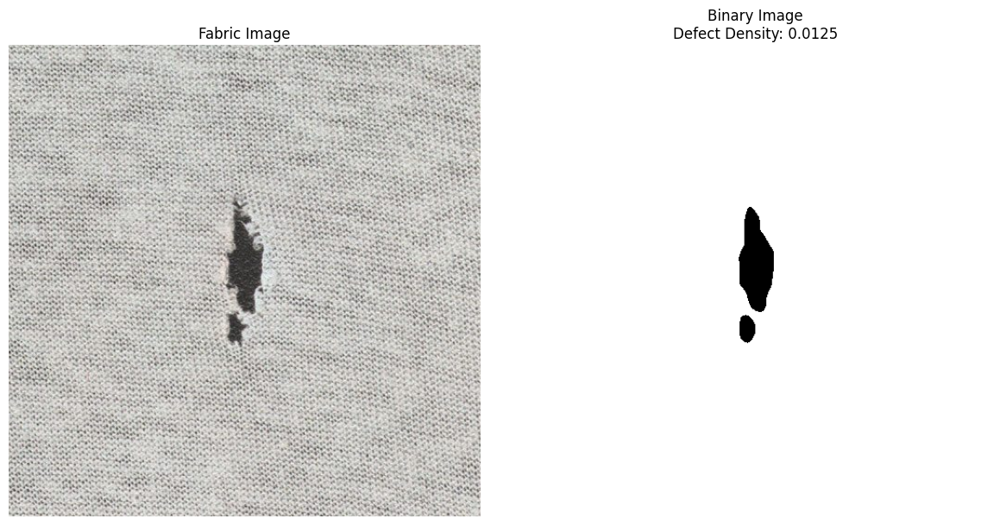

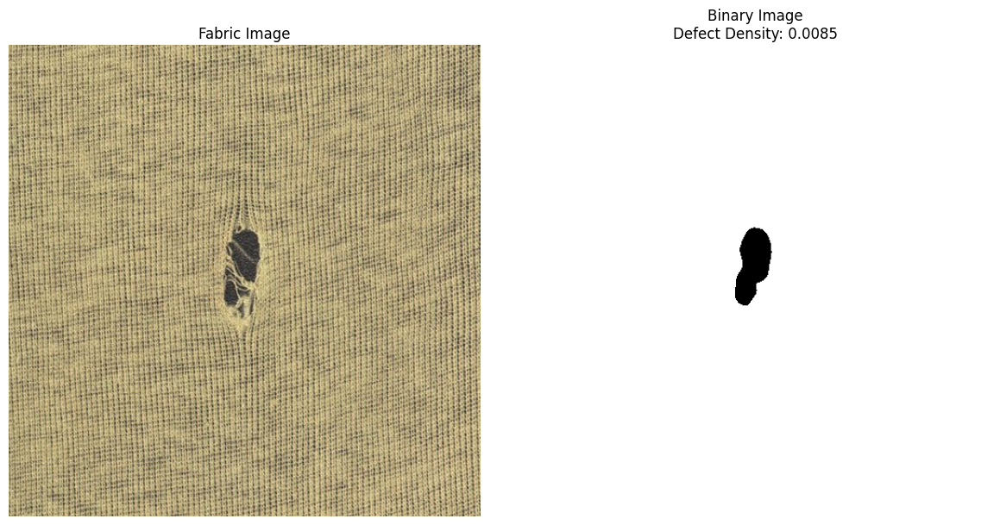

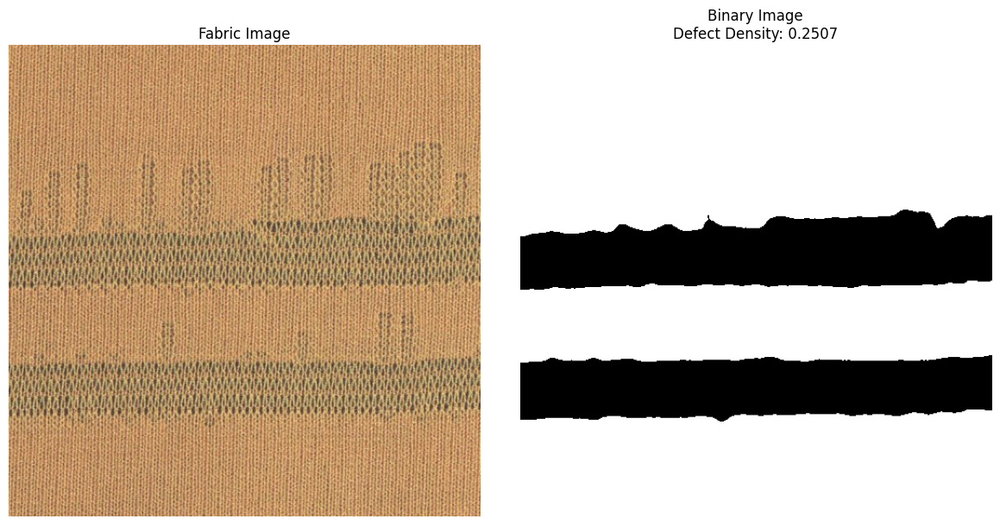

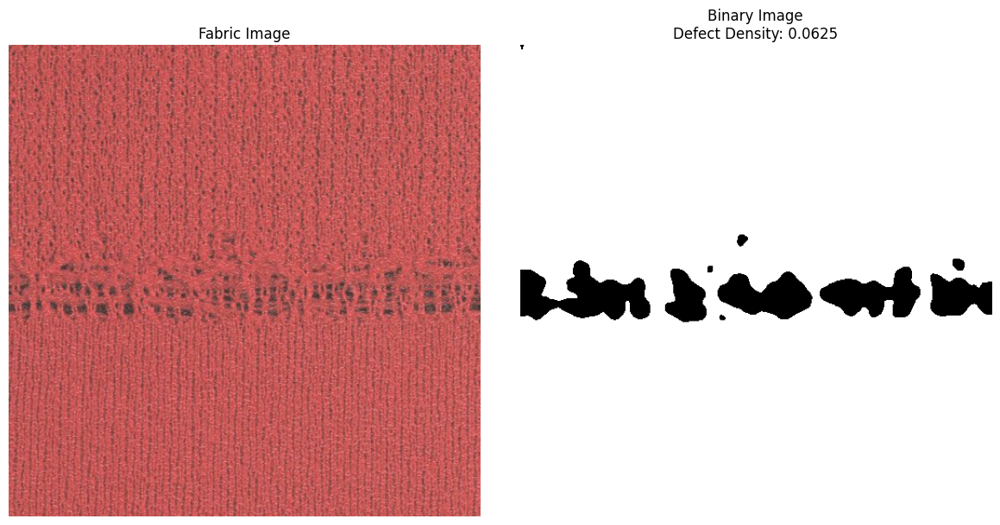

In [10]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

def calculate_defect_density(binary_image):
    # Calculate the area of foreground (defect) and background (non-defect) regions in the binary image
    total_area = binary_image.size
    defect_area = np.count_nonzero(binary_image)  # Count of non-zero pixels (white pixels)

    # Determine which area is smaller (defective area)
    if defect_area > total_area / 2:
        defect_area = total_area - defect_area  # Use the smaller area as the defective area

    # Calculate defect density
    if total_area > 0:
        defect_density = defect_area / total_area
    else:
        defect_density = 0.0
    
    return defect_density

def defect_detect(image):
    img = image.copy()
    # Preprocess the input image
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    v = hsv[:,:,2]
    blr = cv2.blur(v, (15, 15))
    dst = cv2.fastNlMeansDenoising(blr, None, 10, 7, 21)
    _, binary = cv2.threshold(dst, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    
    # Calculate defect density based on the binary image
    defect_density = calculate_defect_density(binary)
    
    return binary, defect_density

# Path to the input images folder
input_folder = 'INPUT_images'

# Process each image in the folder
for filename in os.listdir(input_folder):
    # Read the image
    image_path = os.path.join(input_folder, filename)
    image = cv2.imread(image_path)
    
    if image is None:
        continue
    
    # Detect defects in the image
    binary_image, defect_density = defect_detect(image)
    
    # Display the original image and processed binary image
    plt.figure(figsize=(12, 6))
    
    # Display the original image
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Fabric Image')
    plt.axis('off')
    
    # Display the processed binary image
    plt.subplot(1, 2, 2)
    plt.imshow(binary_image, cmap='gray')
    plt.title(f'Binary Image\nDefect Density: {defect_density:.4f}')
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()
